In [52]:
import pandas  as pd
import numpy   as np
import lightgbm as lgb
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.discriminant_analysis import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
import math
import matplotlib.pyplot as plt
from sklearn.model_selection import cross_val_score, KFold
from sklearn.compose import ColumnTransformer
from utils import run_kfold, run_kfold_eval, run_kfold_trainonly, feature_selection, calculate_metric
from sklearn.pipeline import Pipeline
import optuna
import time
import os

In [57]:
TRAIN_FEATURES = '../Data/final/train_features2.xlsx'
TRAIN_LABELS = "../Data/final/train_labels2.xlsx"
TEST_FEATURES = "../Data/final/test_features2.xlsx"
TEST_LABELS = "../Data/final/test_labels2.xlsx"
OUTPUT_PATH = '../OUTPUT/lightgbm'

In [32]:
train_features = pd.read_excel(TRAIN_FEATURES)
train_labels = pd.read_excel(TRAIN_LABELS)
test_features = pd.read_excel(TEST_FEATURES)
test_labels = pd.read_excel(TEST_LABELS)

In [33]:
print(train_features.shape)
print(train_labels.shape)
print(test_features.shape)
print(test_labels.shape)

(1293, 317)
(1293, 1)
(432, 317)
(432, 1)


In [36]:
train_df = train_features.copy()
train_df['rr1_30'] = train_labels

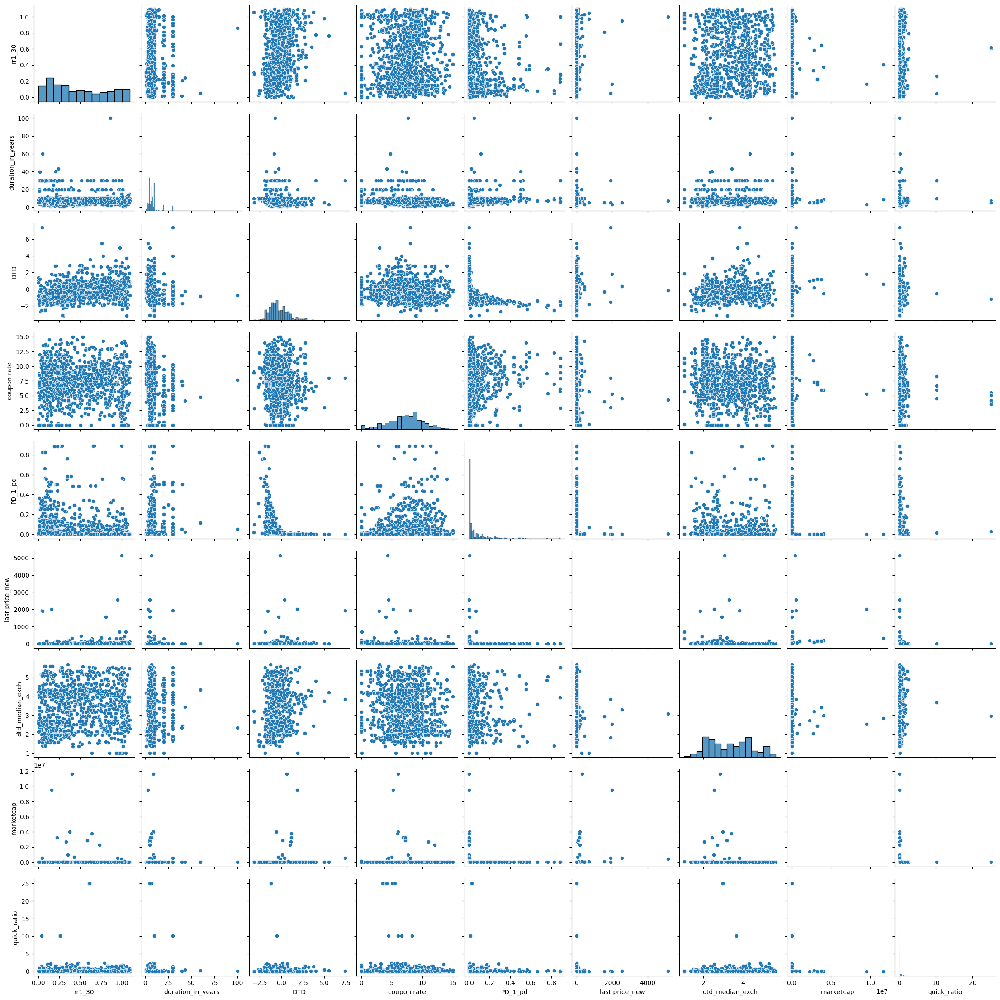

In [37]:
sns.pairplot(train_df[['rr1_30','duration_in_years', 'DTD', 'coupon rate', 'PD_1_pd', 'last price_new', 'dtd_median_exch', 'marketcap', 'quick_ratio']])

In [42]:
feature_list = train_features.columns
category_feature_key = ['currency', 'seniorioty_adj', 'domicile_country',	'exchange_country',	'Industry_sector',	'Industry_group',	'Industry_subgroup', 'event_type',
                 'event_type_subcategory_sum', 'defaulted_in_last_6_months']
category_features = [i for i in feature_list if any(sub in i for sub in category_feature_key)]
non_category_features = [i for i in feature_list if i not in category_features]

print(len(category_features))
print(len(non_category_features))

163
154


In [18]:
## This is needed for linear tree
# Prepare the ColumnTransformer
scaler = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), non_category_features)
    ],
    remainder='passthrough'  # Leave categorical features untouched
)

In [45]:
def objective(trial):
    # Define the hyperparameter search space
    param = {
        'objective': 'regression',
        'metric': 'rmse',  # Root Mean Squared Error
        'boosting_type': trial.suggest_categorical('boosting_type', ['gbdt', 'dart', 'goss']),
        'num_leaves': trial.suggest_int('num_leaves', 2, 256),
        'max_depth': trial.suggest_int('max_depth', -1, 30),
        'learning_rate': trial.suggest_float('learning_rate', 1e-3, 1.0),
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
        'subsample': trial.suggest_float('subsample', 0.1, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.1, 1.0),
        'reg_alpha': trial.suggest_float('reg_alpha', 1e-3, 10.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 1e-3, 10.0),
        'random_state': 42
    }

    model = lgb.LGBMRegressor(**param)
    
    pipeline = Pipeline([
        ('preprocessor', scaler),
        ('xgboost', model)
    ])

    # Perform cross-validation with LightGBM
    score = cross_val_score(pipeline, train_features, train_labels.to_numpy(), cv=5, scoring='neg_root_mean_squared_error', n_jobs=-1).mean()

    # The best score is the minimum RMSE
    return score


In [46]:

study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=50, show_progress_bar=True)

print("Number of finished trials: ", len(study.trials))
print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))
print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

[I 2024-08-21 13:25:19,051] A new study created in memory with name: no-name-c855ba0e-1afb-4665-bae7-e378dc29f315
  0%|          | 0/50 [00:00<?, ?it/s]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005047 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36874
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 245
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

Best trial: 0. Best value: -0.243529:   2%|▏         | 1/50 [00:20<16:43, 20.48s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[I 2024-08-21 13:25:39,533] Trial 0 finished with value: -0.2435287505880852 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 175, 'max_depth': 5, 'learning_rate': 0.01051326957825097, 'n_estimators': 920, 'min_child_samples': 11, 'subsample': 0.11930676279540453, 'colsample_bytree': 0.723833125116269, 'reg_alpha': 1.4495157471006221, 'reg_lambda': 0.37291678816945195}. Best is trial 0 with value: -0.2435287505880852.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003192 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37066
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006606 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36786
[LightGBM] [Info] Number of data points in the train set: 1035, number of used features: 220
[LightGBM] [Info] Start training from score 0.483567
[LightGBM] [Info] Number of dat

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010581 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36965
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006057 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36929
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006437 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36826
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 219
[LightGBM] [Info] Start training from score 0.484991
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 221
[LightGBM] [Info] Number of data points in the train set: 1035, number of used features: 219
[LightGBM] [Info] Start training from score 0.485669
[LightGBM] [Info] Start 

Best trial: 0. Best value: -0.243529:   4%|▍         | 2/50 [00:24<08:32, 10.69s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversio

[I 2024-08-21 13:25:43,362] Trial 1 finished with value: -0.3743148447293091 and parameters: {'boosting_type': 'dart', 'num_leaves': 186, 'max_depth': 22, 'learning_rate': 0.7643833674329287, 'n_estimators': 197, 'min_child_samples': 21, 'subsample': 0.12319793782267231, 'colsample_bytree': 0.9232308242893758, 'reg_alpha': 4.131394214928052, 'reg_lambda': 4.529436747077872}. Best is trial 0 with value: -0.2435287505880852.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004727 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36768
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003990 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36913
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007057 seconds.
You can set

Best trial: 0. Best value: -0.243529:   6%|▌         | 3/50 [00:26<05:18,  6.78s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversio

[I 2024-08-21 13:25:45,496] Trial 2 finished with value: -0.25149713982440397 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 154, 'max_depth': 17, 'learning_rate': 0.1697974273467224, 'n_estimators': 268, 'min_child_samples': 48, 'subsample': 0.17159364584292613, 'colsample_bytree': 0.5424847708924619, 'reg_alpha': 3.526069261905045, 'reg_lambda': 2.2884668472854073}. Best is trial 0 with value: -0.2435287505880852.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004971 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005178 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004789 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36883
[LightGBM] [Info] Total Bins 36704
[LightGBM] [Inf

Best trial: 0. Best value: -0.243529:   8%|▊         | 4/50 [00:27<03:34,  4.66s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversio

[I 2024-08-21 13:25:46,895] Trial 3 finished with value: -0.4315707334112881 and parameters: {'boosting_type': 'dart', 'num_leaves': 248, 'max_depth': 30, 'learning_rate': 0.1271318101593796, 'n_estimators': 100, 'min_child_samples': 91, 'subsample': 0.15245235472351176, 'colsample_bytree': 0.9720378556029078, 'reg_alpha': 2.2328936229683056, 'reg_lambda': 1.3026694892218955}. Best is trial 0 with value: -0.2435287505880852.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005702 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36883
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004752 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 178
[LightGBM] [Info] Total Bins 36704
[LightGBM] [Info] Nu

Best trial: 0. Best value: -0.243529:  10%|█         | 5/50 [00:31<03:14,  4.32s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.

Best trial: 0. Best value: -0.243529:  12%|█▏        | 6/50 [00:36<03:22,  4.61s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversio

[I 2024-08-21 13:25:55,793] Trial 5 finished with value: -0.2803019886106294 and parameters: {'boosting_type': 'goss', 'num_leaves': 52, 'max_depth': 0, 'learning_rate': 0.45133727807797935, 'n_estimators': 539, 'min_child_samples': 27, 'subsample': 0.35870847395890293, 'colsample_bytree': 0.720834246529712, 'reg_alpha': 3.6771381398549137, 'reg_lambda': 7.5709528507107375}. Best is trial 0 with value: -0.2435287505880852.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.024067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36780
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 215
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.128238 seconds.
You can set `force_col_wise=true` to remove the overhead.
[Lig

Best trial: 0. Best value: -0.243529:  14%|█▍        | 7/50 [00:38<02:35,  3.61s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversio

[I 2024-08-21 13:25:57,340] Trial 6 finished with value: -0.26651521011292184 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 120, 'max_depth': 3, 'learning_rate': 0.5880247683966696, 'n_estimators': 471, 'min_child_samples': 22, 'subsample': 0.8889539339691795, 'colsample_bytree': 0.5054161268066092, 'reg_alpha': 7.7373446278205416, 'reg_lambda': 0.7926984594585773}. Best is trial 0 with value: -0.2435287505880852.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006378 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003502 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004486 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not e

Best trial: 0. Best value: -0.243529:  16%|█▌        | 8/50 [00:40<02:11,  3.13s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversio

[I 2024-08-21 13:25:59,452] Trial 7 finished with value: -0.26832604218631656 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 193, 'max_depth': 21, 'learning_rate': 0.7739431100646988, 'n_estimators': 613, 'min_child_samples': 22, 'subsample': 0.18856892699583128, 'colsample_bytree': 0.36946438363193224, 'reg_alpha': 6.890559243920853, 'reg_lambda': 7.580301511827169}. Best is trial 0 with value: -0.2435287505880852.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005411 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36768
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004468 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_co

Best trial: 0. Best value: -0.243529:  18%|█▊        | 9/50 [00:42<01:54,  2.80s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversio

[I 2024-08-21 13:26:01,505] Trial 8 finished with value: -0.25749457640226603 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 160, 'max_depth': 12, 'learning_rate': 0.517628602989179, 'n_estimators': 677, 'min_child_samples': 52, 'subsample': 0.3868538264351228, 'colsample_bytree': 0.19253269967754427, 'reg_alpha': 2.7952283237922178, 'reg_lambda': 1.6641417810402674}. Best is trial 0 with value: -0.2435287505880852.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005676 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008527 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Tot

Best trial: 0. Best value: -0.243529:  20%|██        | 10/50 [00:48<02:27,  3.70s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[I 2024-08-21 13:26:07,222] Trial 9 finished with value: -0.46095883946219374 and parameters: {'boosting_type': 'dart', 'num_leaves': 54, 'max_depth': 3, 'learning_rate': 0.8548430311532518, 'n_estimators': 589, 'min_child_samples': 95, 'subsample': 0.4721442599573086, 'colsample_bytree': 0.8286185760043034, 'reg_alpha': 2.3475399899863603, 'reg_lambda': 7.448746192333377}. Best is trial 0 with value: -0.2435287505880852.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.

Best trial: 10. Best value: -0.24077:  22%|██▏       | 11/50 [01:29<09:47, 15.07s/it]

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[I 2024-08-21 13:26:48,069] Trial 10 finished with value: -0.24077025527378346 and parameters: {'boosting_type': 'goss', 'num_leaves': 246, 'max_depth': 10, 'learning_rate': 0.007364489850544498, 'n_estimators': 990, 'min_child_samples': 5, 'subsample': 0.7159240214601954, 'colsample_bytree': 0.6959372313618496, 'reg_alpha': 0.20248018441244398, 'reg_lambda': 3.7467170356138197}. Best is trial 10 with value: -0.24077025527378346.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.

Best trial: 10. Best value: -0.24077:  24%|██▍       | 12/50 [02:00<12:45, 20.14s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[I 2024-08-21 13:27:19,799] Trial 11 finished with value: -0.2423538542383239 and parameters: {'boosting_type': 'goss', 'num_leaves': 247, 'max_depth': 11, 'learning_rate': 0.011324608375501434, 'n_estimators': 968, 'min_child_samples': 5, 'subsample': 0.7410443498369489, 'colsample_bytree': 0.708903042211619, 'reg_alpha': 0.3750740749645356, 'reg_lambda': 3.913697505831611}. Best is trial 10 with value: -0.24077025527378346.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=g

Best trial: 10. Best value: -0.24077:  26%|██▌       | 13/50 [02:24<13:08, 21.31s/it]

[I 2024-08-21 13:27:43,826] Trial 12 finished with value: -0.2559314311292912 and parameters: {'boosting_type': 'goss', 'num_leaves': 250, 'max_depth': 10, 'learning_rate': 0.2859340877883651, 'n_estimators': 985, 'min_child_samples': 5, 'subsample': 0.7813170564567627, 'colsample_bytree': 0.6626943066265147, 'reg_alpha': 0.35190358026499524, 'reg_lambda': 3.7573509715244757}. Best is trial 10 with value: -0.24077025527378346.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.

Best trial: 10. Best value: -0.24077:  28%|██▊       | 14/50 [02:33<10:25, 17.37s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[I 2024-08-21 13:27:52,069] Trial 13 finished with value: -0.27432954158503503 and parameters: {'boosting_type': 'goss', 'num_leaves': 224, 'max_depth': 10, 'learning_rate': 0.0032484886206964976, 'n_estimators': 849, 'min_child_samples': 37, 'subsample': 0.7022266360377102, 'colsample_bytree': 0.6266148566443819, 'reg_alpha': 9.820954649500617, 'reg_lambda': 3.205690672230115}. Best is trial 10 with value: -0.24077025527378346.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strateg

Best trial: 10. Best value: -0.24077:  30%|███       | 15/50 [02:37<07:49, 13.40s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=g

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.

Best trial: 10. Best value: -0.24077:  32%|███▏      | 16/50 [02:41<06:03, 10.68s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.

Best trial: 10. Best value: -0.24077:  34%|███▍      | 17/50 [03:14<09:30, 17.30s/it]

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[I 2024-08-21 13:28:33,338] Trial 16 finished with value: -0.24723999801208635 and parameters: {'boosting_type': 'goss', 'num_leaves': 212, 'max_depth': 17, 'learning_rate': 0.1585934379948585, 'n_estimators': 798, 'min_child_samples': 5, 'subsample': 0.5747829227869921, 'colsample_bytree': 0.8295394894532482, 'reg_alpha': 0.09327821454119256, 'reg_lambda': 3.407888994380158}. Best is trial 10 with value: -0.24077025527378346.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.

Best trial: 10. Best value: -0.24077:  36%|███▌      | 18/50 [03:18<07:08, 13.39s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[I 2024-08-21 13:28:37,616] Trial 17 finished with value: -0.28113803688136574 and parameters: {'boosting_type': 'goss', 'num_leaves': 256, 'max_depth': 21, 'learning_rate': 0.3960268780702461, 'n_estimators': 435, 'min_child_samples': 39, 'subsample': 0.7928967686849241, 'colsample_bytree': 0.5935735188441231, 'reg_alpha': 1.375800770

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.

Best trial: 10. Best value: -0.24077:  38%|███▊      | 19/50 [03:23<05:36, 10.87s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[I 2024-08-21 13:28:42,613] Trial 18 finished with value: -0.25534665321945427 and parameters: {'boosting_type': 'goss', 'num_leaves': 132, 'max_depth': 7, 'learning_rate': 0.08130995023842374, 'n_estimators': 744, 'min_child_samples': 36, 'subsample': 0.7120613754192601, 'colsample_bytree': 0.10651996213828141, 'reg_alpha': 5.427900785977632, 'reg_lambda': 6.648223234035402}. Best is trial 10 with value: -0.24077025527378346.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=

Best trial: 10. Best value: -0.24077:  40%|████      | 20/50 [03:38<05:59, 12.00s/it]

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[I 2024-08-21 13:28:57,241] Trial 19 finished with value: -0.31424216458951204 and parameters: {'boosting_type': 'goss', 'num_leaves': 214, 'max_depth': 13, 'learning_rate': 0.6378579571852458, 'n_estimators': 874, 'min_child_samples': 14, 'subsample': 0.904947711361793, 'colsample_bytree': 0.7294468352615276, 'reg_alpha': 1.2299265808102562, 'reg_lambda': 2.3636706176759743}. Best is trial 10 with value: -0.24077025527378346.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.

Best trial: 10. Best value: -0.24077:  42%|████▏     | 21/50 [03:43<04:52, 10.08s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006605 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36886
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006848 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 37035
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 254
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 251
[LightGBM] [Info] Start training from score 0.484991
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023420 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36854
[LightGBM] [Info] Number of data points in the train 

Best trial: 10. Best value: -0.24077:  44%|████▍     | 22/50 [04:12<07:16, 15.60s/it]

[I 2024-08-21 13:29:31,330] Trial 21 finished with value: -0.2451269335067267 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 183, 'max_depth': 6, 'learning_rate': 0.003655994984182486, 'n_estimators': 917, 'min_child_samples': 9, 'subsample': 0.27539431469501735, 'colsample_bytree': 0.7309961307811897, 'reg_alpha': 1.3578931585668297, 'reg_lambda': 0.15332736079686066}. Best is trial 10 with value: -0.24077025527378346.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016621 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37001
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 237
[LightGBM] [Info] Start training from score 0.484991
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013416 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36846
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015677 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36810
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020516 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Warning] No further split

Best trial: 10. Best value: -0.24077:  46%|████▌     | 23/50 [04:19<05:54, 13.11s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011873 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004991 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36838
[LightGBM] [Info] Total Bins 36987
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011137 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37082
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.026401 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.026119 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Tot

Best trial: 10. Best value: -0.24077:  48%|████▊     | 24/50 [04:44<07:16, 16.77s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[I 2024-08-21 13:30:03,945] Trial 23 finished with value: -0.2696208563456863 and parameters: {'boosting_type': 'dart', 'num_leaves': 104, 'max_depth': 9, 'learning_rate': 0.08190322132102155, 'n_estimators': 903, 'min_child_samples': 17, 'subsample': 0.6564688184518431, 'colsample_bytree': 0.8985338743120328, 'reg_alpha': 0.7568103461134433, 'reg_lambda': 2.4972634897982}. Best is trial 10 with value: -0.24077025527378346.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=gos

Best trial: 10. Best value: -0.24077:  48%|████▊     | 24/50 [04:52<07:16, 16.77s/it]

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[I 2024-08-21 13:30:11,706] Trial 24 finished with value: -0.25475579808270826 and parameters: {'boosting_type': 'goss', 'num_leaves': 199, 'max_depth': 12, 'learning_rate': 0.08036979615889704, 'n_estimators': 786, 'min_child_samples': 31, 'subsample': 0.8255003009214797, 'colsample_bytree': 0.7996615925620395, 'reg_alpha': 2.0194835960640205, 'reg_lambda': 4.345027044791849}. Best is trial 10 with value: -0.24077025527378346.


Best trial: 10. Best value: -0.24077:  50%|█████     | 25/50 [04:52<05:51, 14.07s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016762 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 37065
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024926 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37148
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 269
[LightGBM] [Info] Start training from score 0.484991
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.039845 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 37027
[LightGBM] [Info] Number of data points in the train set: 1035, number of used features: 261
[LightGBM] [Info] Start training from scor

Best trial: 10. Best value: -0.24077:  50%|█████     | 25/50 [04:58<05:51, 14.07s/it]

[I 2024-08-21 13:30:17,177] Trial 25 finished with value: -0.24841371679746888 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 148, 'max_depth': 4, 'learning_rate': 0.21299243966584974, 'n_estimators': 934, 'min_child_samples': 5, 'subsample': 0.5728259565319775, 'colsample_bytree': 0.8992853218259138, 'reg_alpha': 2.972503184504081, 'reg_lambda': 9.805490884847885}. Best is trial 10 with value: -0.24077025527378346.


Best trial: 10. Best value: -0.24077:  52%|█████▏    | 26/50 [04:58<04:37, 11.55s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013686 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36806
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this

Best trial: 10. Best value: -0.24077:  54%|█████▍    | 27/50 [05:13<04:49, 12.58s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[I 2024-08-21 13:30:32,389] Trial 26 finished with value: -0.8214725923315509 and parameters: {'boosting_type': 'goss', 'num_leaves': 231, 'max_depth': 15, 'learning_rate': 0.9852164859987349, 'n_estimators': 851, 'min_child_samples': 16, 'subsample': 0.7304932439909582, 'colsample_bytree': 0.9839445641080768, 'reg_alpha': 0.9204651691355314, 'reg_lambda': 8.645662389551205}. Best is trial 10 with value: -0.24077025527378346.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=g

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025786 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Total Bins 36802
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this

Best trial: 10. Best value: -0.24077:  56%|█████▌    | 28/50 [05:19<03:56, 10.77s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[I 2024-08-21 13:30:38,936] Trial 27 finished with value: -0.28826207022652245 and parameters: {'boosting_type': 'goss', 'num_leaves': 77, 'max_depth': 18, 'learning_rate': 0.3649507820077261, 'n_est

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003744 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36915
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 194
[LightGBM] [Info] Start training from score 0.484991
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003702 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36772
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 194
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

Best trial: 10. Best value: -0.24077:  58%|█████▊    | 29/50 [05:25<03:10,  9.09s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[I 2024-08-21 13:30:44,091] Trial 28 finished with value: -0.43305976061562523 and parameters: {'boosting_type': 'dart', 'num_leaves': 166, 'max_depth': -1, 'learning_rate': 0.09835054017794224, 'n_estimators': 363, 'min_child_samples': 44, 'subsample': 0.8632345002337951, 'colsample_bytree': 0.7790333738143567, 'reg_alpha': 4.404744793914491, 'reg_lambda': 1.6309042287373692}. Best is trial 10 with value: -0.24077025527378346.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004412 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004352 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004005 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37015
[LightGBM] [Info] Total Bins 36862
[LightGBM] [

Best trial: 10. Best value: -0.24077:  60%|██████    | 30/50 [05:30<02:41,  8.09s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[I 2024-08-21 13:30:49,851] Trial 29 finished with value: -0.2449717340788299 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 198, 'max_depth': 5, 'learning_rate': 0.04370685188152555, 'n_estimators': 917, 'min_child_samples': 12, 'subsample': 0.5194614609717582, 'colsample_bytree': 0.5996263570824563, 'reg_alpha': 1.869117348612501, 'reg_lambda': 3.952080584835551}. Best is trial 10 with value: -0.24077025527378346.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005997 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004553 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36874
[LightGBM] [Info] Total Bins 36842
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 246
[LightGBM] [Info] Nu

Best trial: 10. Best value: -0.24077:  62%|██████▏   | 31/50 [05:34<02:10,  6.85s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversi

[I 2024-08-21 13:30:53,818] Trial 30 finished with value: -0.2429404701978227 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 137, 'max_depth': 11, 'learning_rate': 0.238375388317319, 'n_estimators': 746, 'min_child_samples': 11, 'subsample': 0.9379479816107934, 'colsample_bytree': 0.8733544198840915, 'reg_alpha': 0.8826361553339945, 'reg_lambda': 5.3610692748492355}. Best is trial 10 with value: -0.24077025527378346.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010136 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36818
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 234
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005392 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36967
[LightGBM] [Info] Auto-choosin

Best trial: 10. Best value: -0.24077:  64%|██████▍   | 32/50 [05:38<01:48,  6.05s/it]

[I 2024-08-21 13:30:58,006] Trial 31 finished with value: -0.24208973100222772 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 127, 'max_depth': 11, 'learning_rate': 0.2183009224811622, 'n_estimators': 751, 'min_child_samples': 14, 'subsample': 0.9724659550132346, 'colsample_bytree': 0.8636145317630887, 'reg_alpha': 0.7168354901534895, 'reg_lambda': 5.102640421472339}. Best is trial 10 with value: -0.24077025527378346.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.050781 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36794
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 222
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.264479 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.263438 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.073598 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37070
[LightGBM] [Info] Total Bins 36830
[LightGBM] [Info] Total Bins 36969
[LightGBM] [Info] Number of data points in the train set: 1035, nu

Best trial: 32. Best value: -0.238066:  66%|██████▌   | 33/50 [05:59<02:58, 10.51s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConvers

[I 2024-08-21 13:31:18,908] Trial 32 finished with value: -0.2380659045586459 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 116, 'max_depth': 8, 'learning_rate': 0.1536922604717328, 'n_estimators': 954, 'min_child_samples': 20, 'subsample': 0.7561301261240786, 'colsample_bytree': 0.7521435738116289, 'reg_alpha': 0.03194741824447472, 'reg_lambda': 4.941128690293196}. Best is trial 32 with value: -0.2380659045586459.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006106 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36826
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019758 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36965
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 221
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 219
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015880 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 37066
[LightGBM] [Info] Start training from score 0.484991
[LightGBM] [Info] Number of data points in the train 

Best trial: 32. Best value: -0.238066:  68%|██████▊   | 34/50 [06:04<02:17,  8.62s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConvers

[I 2024-08-21 13:31:23,132] Trial 33 finished with value: -0.24450905149835936 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 109, 'max_depth': 7, 'learning_rate': 0.14989704173273244, 'n_estimators': 871, 'min_child_samples': 21, 'subsample': 0.9891989955994652, 'colsample_bytree': 0.7607036066495704, 'reg_alpha': 1.7133592909011668, 'reg_lambda': 6.317396953645087}. Best is trial 32 with value: -0.2380659045586459.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011566 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36766
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 208
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004460 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

Best trial: 32. Best value: -0.238066:  70%|███████   | 35/50 [06:17<02:31, 10.10s/it]

[I 2024-08-21 13:31:36,693] Trial 34 finished with value: -0.2422860116557331 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 75, 'max_depth': 14, 'learning_rate': 0.335135948578225, 'n_estimators': 939, 'min_child_samples': 27, 'subsample': 0.6770863426947384, 'colsample_bytree': 0.9448295784307971, 'reg_alpha': 0.05616149073817012, 'reg_lambda': 4.9115625169360575}. Best is trial 32 with value: -0.2380659045586459.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.369843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36782
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.200246 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36929
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 201
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 199
[LightGBM] [Info] Start training from score 0.484991
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [In

Best trial: 32. Best value: -0.238066:  72%|███████▏  | 36/50 [06:21<01:56,  8.29s/it]

[I 2024-08-21 13:31:40,736] Trial 35 finished with value: -0.24819607627933035 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 74, 'max_depth': 14, 'learning_rate': 0.3696037021509788, 'n_estimators': 799, 'min_child_samples': 31, 'subsample': 0.7822144682420777, 'colsample_bytree': 0.9595061361329471, 'reg_alpha': 2.6380166168943875, 'reg_lambda': 4.8447262153384285}. Best is trial 32 with value: -0.2380659045586459.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012751 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36808
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 212
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006853 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36778
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 214
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013205 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total 

Best trial: 32. Best value: -0.238066:  74%|███████▍  | 37/50 [06:30<01:51,  8.58s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConvers

[I 2024-08-21 13:31:50,010] Trial 36 finished with value: -0.24307278354825979 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 85, 'max_depth': 18, 'learning_rate': 0.3305132531284286, 'n_estimators': 950, 'min_child_samples': 24, 'subsample': 0.8460587989359153, 'colsample_bytree': 0.9423920079952788, 'reg_alpha': 0.1293627403771721, 'reg_lambda': 5.068759974606702}. Best is trial 32 with value: -0.2380659045586459.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007119 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36772
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 194
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003582 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Info] Total Bins 36738
[LightGBM] [Info] Number of dat

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004290 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37014
[LightGBM] [Info] Number of data points in the train set: 1035, number of used features: 194
[LightGBM] [Info] Start training from score 0.483567
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

Best trial: 32. Best value: -0.238066:  76%|███████▌  | 38/50 [06:33<01:20,  6.75s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012232 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36804
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006967 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009862 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 227
[LightGBM] [Info] Total Bins 36834
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Total Bins 36981
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 227
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 225
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Info] Auto-c

Best trial: 32. Best value: -0.238066:  78%|███████▊  | 39/50 [06:34<00:56,  5.15s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002624 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36782
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 199
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004134 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36746
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 198
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006192 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [I

Best trial: 32. Best value: -0.238066:  80%|████████  | 40/50 [06:37<00:43,  4.36s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConvers

[I 2024-08-21 13:31:56,432] Trial 39 finished with value: -0.26234016405926386 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 107, 'max_depth': 16, 'learning_rate': 0.12521815563509048, 'n_estimators': 683, 'min_child_samples': 32, 'subsample': 0.6085518667068616, 'colsample_bytree': 0.9348961713429297, 'reg_alpha': 8.45466403678501, 'reg_lambda': 4.2155179154198805}. Best is trial 32 with value: -0.2380659045586459.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007379 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36750
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 183
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of tes

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Total Bins 36718
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 184
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

Best trial: 32. Best value: -0.238066:  82%|████████▏ | 41/50 [06:46<00:51,  5.69s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConvers

[I 2024-08-21 13:32:05,214] Trial 40 finished with value: -0.5418247147839468 and parameters: {'boosting_type': 'dart', 'num_leaves': 122, 'max_depth': 2, 'learning_rate': 0.2364685475985203, 'n_estimators': 837, 'min_child_samples': 60, 'subsample': 0.756091202826241, 'colsample_bytree': 0.7701743994224881, 'reg_alpha': 4.32806679391662, 'reg_lambda': 5.121283207467625}. Best is trial 32 with value: -0.2380659045586459.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003223 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36770
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009727 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 210
[LightGBM] [Info] Total Bins 36806
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Number of data po

Best trial: 32. Best value: -0.238066:  84%|████████▍ | 42/50 [06:53<00:49,  6.15s/it]

[I 2024-08-21 13:32:12,443] Trial 41 finished with value: -0.24089242843485667 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 99, 'max_depth': 8, 'learning_rate': 0.057916734419133586, 'n_estimators': 896, 'min_child_samples': 26, 'subsample': 0.6783155799049487, 'colsample_bytree': 0.8786520569298998, 'reg_alpha': 0.8271567287232866, 'reg_lambda': 0.9246766956124794}. Best is trial 32 with value: -0.2380659045586459.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007016 seconds.
You can set `force_col_wise=true` to remove the overhead.[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007147 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013707 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.

[LightGBM] [Info] Total Bins 36808
[LightGBM] [Info] Total Bins 36776
[LightGBM] [Info] Total Bins 36953
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 212
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 213
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 213
[LightGBM] [I

Best trial: 32. Best value: -0.238066:  86%|████████▌ | 43/50 [06:59<00:42,  6.06s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005748 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36740
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 178
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010380 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36708
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 179
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012807 secon

Best trial: 32. Best value: -0.238066:  88%|████████▊ | 44/50 [07:03<00:33,  5.54s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConvers

[I 2024-08-21 13:32:22,616] Trial 43 finished with value: -0.24930474136799816 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 65, 'max_depth': 8, 'learning_rate': 0.19411271450813147, 'n_estimators': 995, 'min_child_samples': 79, 'subsample': 0.820697816953566, 'colsample_bytree': 0.6752647768705531, 'reg_alpha': 1.7123728419967383, 'reg_lambda': 2.7012948902757117}. Best is trial 32 with value: -0.2380659045586459.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004286 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004325 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004859 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36826
[LightGBM] [Info] Total Bins 36965
[LightGBM] [Info] Total Bins 36786
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007990 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37066
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 219
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 218
[LightGBM] [Info] Start tr

Best trial: 32. Best value: -0.238066:  90%|█████████ | 45/50 [07:09<00:27,  5.53s/it]

[I 2024-08-21 13:32:28,127] Trial 44 finished with value: -0.24099611087684053 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 143, 'max_depth': 12, 'learning_rate': 0.12402140634431737, 'n_estimators': 871, 'min_child_samples': 21, 'subsample': 0.4536131092423062, 'colsample_bytree': 0.916251444192959, 'reg_alpha': 0.7534628364774745, 'reg_lambda': 0.801968877477865}. Best is trial 32 with value: -0.2380659045586459.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015966 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36882
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013365 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 37029
[LightGBM] [Info] Total Bins 36844
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 251
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 249
[LightGBM] [Info] Start training from score 0.484991
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Info] Number of data points in the train 

Best trial: 32. Best value: -0.238066:  92%|█████████▏| 46/50 [07:17<00:25,  6.34s/it]

[I 2024-08-21 13:32:36,353] Trial 45 finished with value: -0.24504275812441406 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 142, 'max_depth': 11, 'learning_rate': 0.03209524403945164, 'n_estimators': 870, 'min_child_samples': 10, 'subsample': 0.4650620381533913, 'colsample_bytree': 0.9083691551681299, 'reg_alpha': 2.3518328201426386, 'reg_lambda': 0.7907940240053559}. Best is trial 32 with value: -0.2380659045586459.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006815 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36780
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 215
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003669 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 37062
[LightGBM] [Info] Number of data points in the train set: 1035, number of used features: 218
[LightGBM] [Info] Start training from score 0.483567
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005824 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total 

Best trial: 32. Best value: -0.238066:  94%|█████████▍| 47/50 [07:26<00:21,  7.08s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConvers

[I 2024-08-21 13:32:45,155] Trial 46 finished with value: -0.24096355333945102 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 96, 'max_depth': 12, 'learning_rate': 0.10630727818892713, 'n_estimators': 558, 'min_child_samples': 22, 'subsample': 0.32348605427835486, 'colsample_bytree': 0.5510078520833195, 'reg_alpha': 0.4373116531246408, 'reg_lambda': 0.8228454462876327}. Best is trial 32 with value: -0.2380659045586459.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002708 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008231 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36830
[LightGBM] [Info] Total Bins 36794
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 222
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011507 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36969
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022496 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bi

Best trial: 32. Best value: -0.238066:  96%|█████████▌| 48/50 [07:32<00:13,  6.98s/it]

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36830
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 223
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014159 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36794
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 222
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006970 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36969
[LightGBM] [Info] Auto-choosing col-wise multi-thread

Best trial: 32. Best value: -0.238066:  98%|█████████▊| 49/50 [07:39<00:06,  6.93s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[I 2024-08-21 13:32:58,709] Trial 48 finished with value: -0.252995257272736 and parameters: {'boosting_type': 'dart', 'num_leaves': 114, 'max_depth': 9, 'learning_rate': 0.05660155575660473, 'n_estimators': 324, 'min_child_samples': 20, 'subsample': 0.28894800758415407, 'colsample_bytree': 0.5325324210052558, 'reg_alpha': 1.446911133647671, 'reg_lambda': 1.9896296756275684}. Best is trial 32 with value: -0.2380659045586459.


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change t

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003565 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36768
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 192
[LightGBM] [Info] Start training from score 0.482713
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.146361 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36734
[LightGBM] [Info] Number of data points in the train set: 1034, number of used features: 192
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score 0.480394
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.0

Best trial: 32. Best value: -0.238066: 100%|██████████| 50/50 [07:42<00:00,  9.24s/it]

[I 2024-08-21 13:33:01,146] Trial 49 finished with value: -0.25178197041985273 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 32, 'max_depth': 7, 'learning_rate': 0.10626568518119286, 'n_estimators': 262, 'min_child_samples': 51, 'subsample': 0.1097650170514474, 'colsample_bytree': 0.49749818096926085, 'reg_alpha': 3.847589148284694, 'reg_lambda': 1.022717779896956}. Best is trial 32 with value: -0.2380659045586459.
Number of finished trials:  50
Best trial:
  Value: -0.2380659045586459
  Params: 
    boosting_type: gbdt
    num_leaves: 116
    max_depth: 8
    learning_rate: 0.1536922604717328
    n_estimators: 954
    min_child_samples: 20
    subsample: 0.7561301261240786
    colsample_bytree: 0.7521435738116289
    reg_alpha: 0.03194741824447472
    reg_lambda: 4.941128690293196


In [60]:
start_time = time.time()

# Get the best hyperparameters
best_params = study.best_params

model = lgb.LGBMRegressor(n_jobs=-1,**best_params)
pipeline = Pipeline([
        ('preprocessor', scaler),
        ('xgboost', model)
    ])

pipeline.fit(train_features, train_labels.to_numpy())

elapsed_time = time.time() - start_time
print(f"Training time: {elapsed_time:.3f} seconds")

# do prediction
predictions = pipeline.predict(test_features)

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003126 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37244
[LightGBM] [Info] Number of data points in the train set: 1293, number of used features: 230
[LightGBM] [Info] Start training from score 0.483467
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

In [61]:

# save metrics
mae, mape, rmse, rsqr = calculate_metric(predictions, test_labels['rr1_30'].to_numpy())
print(f"Val average mean absolute error: {mae}")
print(f"Val average mean absolute percentage error: {mape}")
print(f"Val average root mean squared error: {rmse}")
print(f"Val average R2: {rsqr}")

Val average mean absolute error: 0.13464712444983937
Val average mean absolute percentage error: 300.7989826889087
Val average root mean squared error: 0.22534272929679616
Val average R2: 0.556682595270718


In [50]:
### Feature importance 

# Create a DataFrame for better visualization
feature_importances = pd.DataFrame({
    'Feature': feature_list,
    'Importance': model.feature_importances_
})

# Sort the features by importance
feature_importances = feature_importances.sort_values(by='Importance', ascending=True)

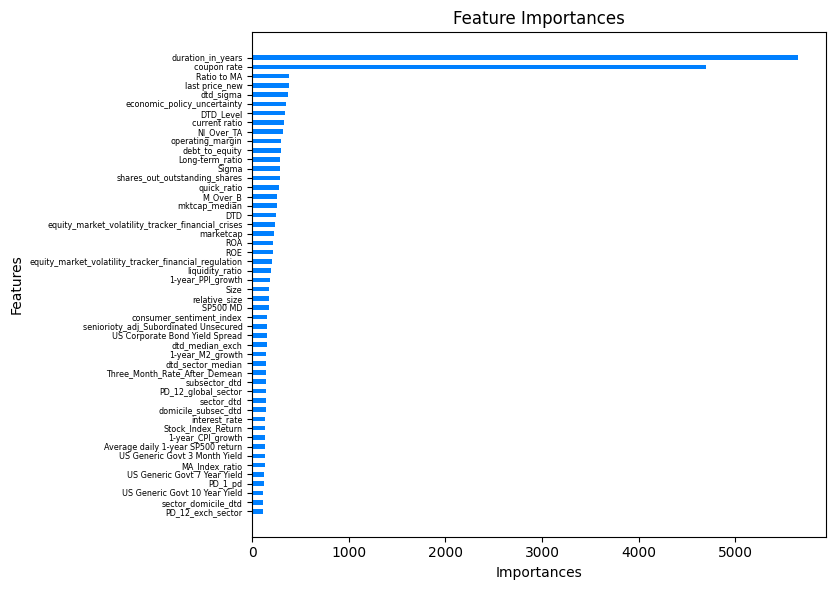

In [53]:
# Create a horizontal bar chart
plt.figure(figsize=(10, 6))  # Adjust the size of the plot as needed
plt.barh(feature_importances['Feature'].tail(50), feature_importances['Importance'].tail(50), color=(0, 0.5, 1), height=0.5)  # Adjust the height for spacing

plt.ylabel('Features')  # Label for the y-axis
plt.xlabel('Importances')  # Label for the x-axis
plt.title('Feature Importances')  # Title of the plot
plt.tight_layout()  # Automatically adjust subplot parameters to give specified padding
plt.yticks(fontsize='xx-small')
plt.savefig(os.path.join(OUTPUT_PATH,'rf_feature_importance.png'))

plt.show()

5-fold CV

In [54]:
features = pd.concat([train_features, test_features], axis=0, ignore_index=True)
features

,coupon rate,SP500 MD,Average daily 1-year SP500 return,Ratio to MA,US Corporate Bond Yield Spread,US Corporate Bond Yield Spread(3-5 year),US Corporate Bond Yield Spread(5-7 year),US Corporate Bond Yield Spread(7-10 year),US Corporate Bond Yield Spread(10+ year),US Generic Govt 3 Month Yield,...,event_type_subcategory_sum_Missing Coupon payment only,event_type_subcategory_sum_Missing Interest payment,event_type_subcategory_sum_Missing Loan payment,event_type_subcategory_sum_Missing Principal payment,event_type_subcategory_sum_Others,event_type_subcategory_sum_Pre-Negotiated Chapter 11,event_type_subcategory_sum_Protection,event_type_subcategory_sum_Receivership,event_type_subcategory_sum_Rehabilitation,event_type_subcategory_sum_Restructuring
0,7.500,-117.46020,-0.000189,125.407139,177.213028,134.012054,198.8153,191.364395,223.346344,0.1983,...,True,False,False,False,False,False,False,False,False,False
1,6.000,166.38276,0.000768,-4.603446,101.613617,77.032829,123.3998,105.932022,139.111115,0.0355,...,False,False,False,False,False,False,False,False,False,False
2,11.000,119.85752,0.000678,-11.950380,104.545959,77.416649,129.4317,111.818001,139.717407,0.0101,...,False,False,False,False,False,False,False,False,False,False
3,9.125,653.51208,0.001638,-2.494861,90.736633,64.654129,95.3731,92.141212,121.666237,0.0152,...,False,False,False,False,False,False,False,False,False,False
4,9.250,231.89472,0.000664,4.823413,98.533821,68.759308,93.4174,107.424469,139.741165,1.2865,...,False,False,False,False,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1720,3.250,147.33344,0.000556,3.538252,128.976395,95.360374,138.8445,138.946106,172.733887,0.0000,...,False,False,False,False,False,False,False,False,False,False
1721,10.000,175.31656,0.000554,-4.067337,121.170998,92.879501,123.2500,131.104904,162.916901,0.7516,...,False,True,False,False,False,False,False,False,False,False
1722,7.450,315.81748,0.000747,8.604100,126.786606,89.018188,114.9728,131.522430,171.701096,0.0864,...,False,False,False,False,False,False,False,False,False,False
1723,0.500,31.75120,-0.000157,-4.373852,126.595230,105.460007,121.6212,147.382416,163.772141,4.8375,...,False,False,False,False,False,False,False,False,False,False


In [55]:
labels = pd.concat([train_labels, test_labels], axis=0, ignore_index=True)
labels

,rr1_30
0,0.082481
1,0.378845
2,0.836149
3,0.987208
4,1.021458
...,...
1720,0.471411
1721,0.823750
1722,0.241612
1723,0.762054


In [56]:
model = lgb.LGBMRegressor(n_jobs=-1, **best_params)
pipeline = Pipeline([
    ('preprocessor', scaler),
    ('svr', model)
])
pipeline.fit(train_features, train_labels)

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002227 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37244
[LightGBM] [Info] Number of data points in the train set: 1293, number of used features: 230
[LightGBM] [Info] Start training from score 0.483467
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/compose/_column_transformer.py:1623: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num', StandardScaler(),
                                                  ['coupon rate', 'SP500 MD',
                                                   'Average daily 1-year SP500 '
                                                   'return',
                                                   'Ratio to MA',
                                                   'US Corporate Bond Yield '
                                                   'Spread',
                                                   'US Corporate Bond Yield '
                                                   'Spread(3-5 year)',
                                                   'US Corporate Bond Yield '
                                                   'Spread(5-7 year)',
                                                   'US Corporate Bond Yield '
                                                   'Spread(7-10 year)',
                                                   'US Corporate Bond...
                                                   'PD_1_domicile_subsec',
                                                   'PD_3_domicile_subsec',
                                                   'PD_12_domicile_subsec',
                                                   'PD_1_exch_sector',
                                                   'PD_3_exch_sector',
                                                   'PD_12_exch_sector', ...])])),
                ('svr',
                 LGBMRegressor(colsample_bytree=0.7521435738116289,
                               learning_rate=0.1536922604717328, max_depth=8,
                               n_estimators=954, n_jobs=-1, num_leaves=116,
                               reg_alpha=0.03194741824447472,
                               reg_lambda=4.941128690293196,
                               subsample=0.7561301261240786))])

In [58]:
train_preds, oof_preds, feat_importances, train_metrics, val_metrics = run_kfold_eval(features, labels.to_numpy(), n_folds=5, model=pipeline, model_params=None, output_path=OUTPUT_PATH, name="lightgbm")

  0%|          | 0/5 [00:00<?, ?it/s]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002003 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37167
[LightGBM] [Info] Number of data points in the train set: 1380, number of used features: 236
[LightGBM] [Info] Start training from score 0.483099
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

 20%|██        | 1/5 [00:07<00:29,  7.29s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37329
[LightGBM] [Info] Number of data points in the train set: 1380, number of used features: 236
[LightGBM] [Info] Start training from score 0.487195
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

 40%|████      | 2/5 [00:15<00:22,  7.54s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002537 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37186
[LightGBM] [Info] Number of data points in the train set: 1380, number of used features: 234
[LightGBM] [Info] Start training from score 0.485268
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

 60%|██████    | 3/5 [00:25<00:17,  8.75s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002696 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37314
[LightGBM] [Info] Number of data points in the train set: 1380, number of used features: 235
[LightGBM] [Info] Start training from score 0.487692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

 80%|████████  | 4/5 [00:31<00:07,  7.76s/it]/Users/hoanguyen/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/Recovery rate forecasting/.venv312/lib/python3.12/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002291 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 37095
[LightGBM] [Info] Number of data points in the train set: 1380, number of used features: 232
[LightGBM] [Info] Start training from score 0.479268
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

100%|██████████| 5/5 [00:41<00:00,  8.20s/it]


In [59]:
# print test resuls
mae = 0
mape = 0
rmse = 0
rsqr = 0
i = 0

for key, value in val_metrics.items():
  if "mae" in key:
    i += 1
    mae += value

  if "mape" in key:
    mape += value

  if "rmse" in key:
    rmse += value

  if "rsqr" in key:
    rsqr += value

print(f"Test average mean absolute error: {mae/i}")
print(f"Test average mean absolute percentage error: {mape/i}")
print(f"Test average root mean squared error: {rmse/i}")
print(f"Test average R2: {rsqr/i}")

Test average mean absolute error: 0.3576421255471279
Test average mean absolute percentage error: 3682.035525557654
Test average root mean squared error: 0.21533761860575154
Test average R2: 0.5772347819586552
